In [26]:
import numpy as np
import cv2
from IPython.display import Image, display


def imshow(img):
    """ndarray 配列をインラインで Notebook 上に表示する。
    """
    ret, encoded = cv2.imencode(".png", img)
    display(Image(encoded))

def adjust(img, alpha=1.0, beta=0.0):
    # 積和演算を行う。
    dst = alpha * img + beta
    # [0, 255] でクリップし、uint8 型にする。
    return np.clip(dst, 0, 255).astype(np.uint8)

def rot_hue(hsv,rot,area1,area2):
    hsv[:, :, 0] = np.where(hsv[:, :, 0]>area1,hsv[:, :, 0]+rot,hsv[:, :, 0])
    hsv[:, :, 0] = np.where(hsv[:, :, 0]>area2,hsv[:, :, 0]-rot,hsv[:, :, 0])
    return hsv


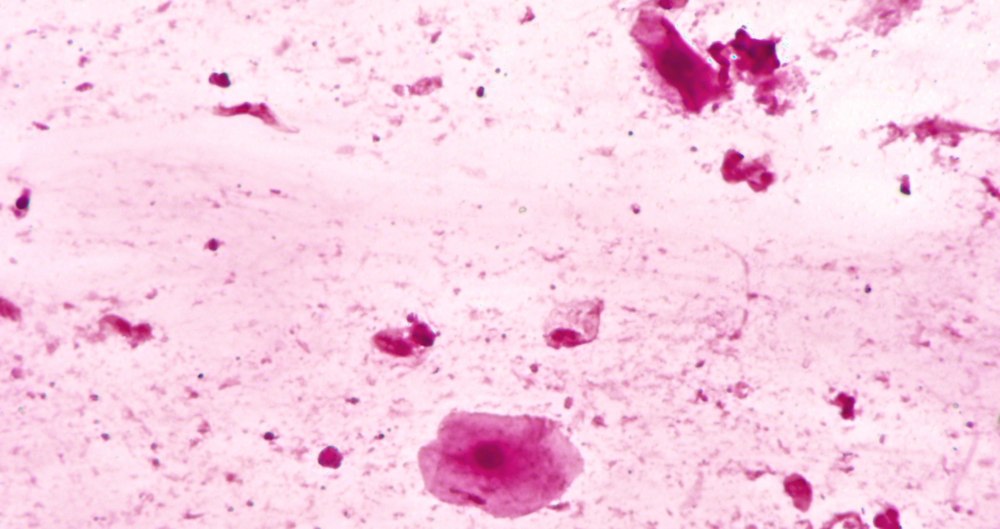

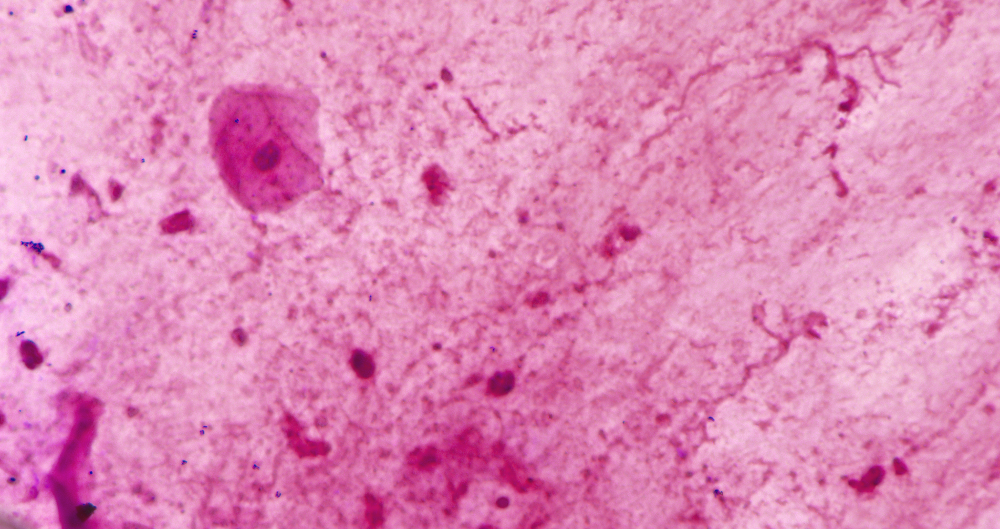

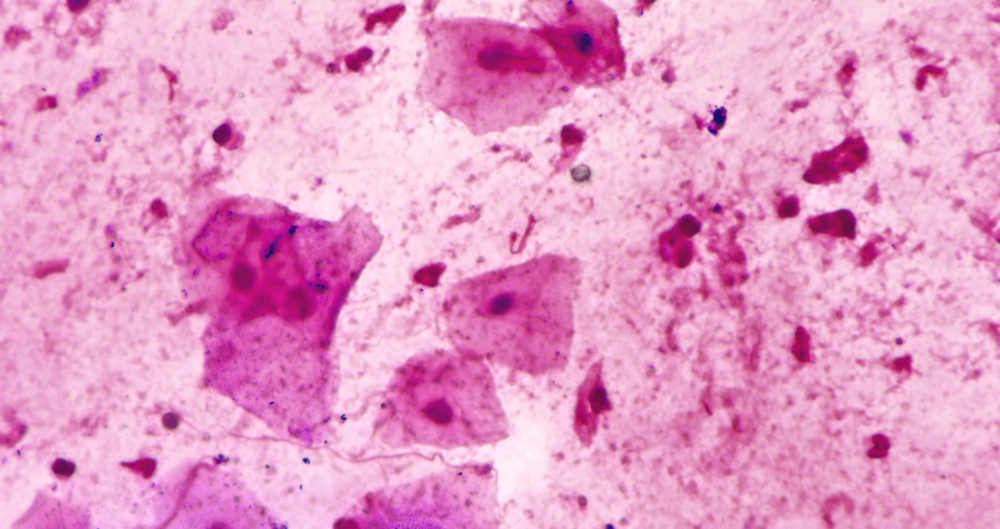

In [27]:
i = 0
rot = 13
for i in range(3):

    fname = "image/old/"+str(i+1)+".png"#画像ファイル名
    img = cv2.imread(fname)#RGB状態で読み込み
    hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)#hsv系で読み込み

    #領域指定での回転
    hsv = rot_hue(hsv,rot,130,170)
    hsv = rot_hue(hsv,-rot,0,30)

    #明度を変更．
    #hsv[:,:,2] = hsv[:,:,2]+20

    #彩度を変更
    #hsv[:,:,1]= hsv[:,:,1]+0

    #色相を変更
    #hsv[:,:,0] = np.where(hsv[:, :, 0]<45,hsv[:, :, 0]==170,hsv[:, :, 0])

    bgr = cv2.cvtColor(hsv, cv2.COLOR_HSV2BGR)

    #bgr変更
    bgr[:,:,2] = bgr[:,:,2]+10

    #0~alpha~2, -100~beta~100
    dst = adjust(bgr, alpha=1.0, beta=15.0)
    imshow(dst)

    cv2.imwrite(str(i+1)+"hsv_converter"+str(rot)+".png",dst)